In [1]:
import numpy as np
import pandas as pd
from tqdm import tqdm
import random
import matplotlib.pyplot as plt
import seaborn as sns 
import datetime
import math
import gc
import time


from IPython.display import clear_output

from sklearn.metrics import roc_auc_score

import lightgbm as lgbm

import pickle
def dump_pkl(data, filename):
  with open(filename, 'wb') as handle:
    pickle.dump(data, handle, protocol=pickle.HIGHEST_PROTOCOL)

def load_pkl(filename):
  with open(filename, 'rb') as handle:
    data = pickle.load(handle)
  return data



In [114]:
def get_income_rate(x_start, x_end, y_start, y_end):
    #close_x 
    income_rate_x = x_end / x_start
    #close_y
    income_rate_y = (2*y_start - y_end) / y_start    
    income_rate =  1 + ((income_rate_x - 1) + (income_rate_y - 1))/2
    
    return income_rate

In [3]:
def double_ma_long(df_cp, Wx=None, Wy=None):
    # Wx < Wy
    df = df_cp.copy()
    df[f'ration_ma_Wx'] = df[f'ration'].rolling(window=Wx, min_periods=Wx).mean().values
    df[f'ration_ma_Wy'] = df[f'ration'].rolling(window=Wy, min_periods=Wy).mean().values

    # #mask_Wy
    # mask_Wy = df[f'close_ma_Wy'].notnull()
    # df = df[mask_Wy].reset_index(drop=True)

    inds_long = np.argwhere(df[f'ration_ma_Wx'] > df[f'ration_ma_Wy']).ravel()
    # if inds_long.shape[0] == 0:
    #     return pd.DataFrame()

    
    #эту штуку нужно дорабатывать до кейса с одним пробегом, либо засовывать в функцию большие промежутки данных
    i_start = 0
    if inds_long[0] == 0:
        i_start = 1
        while inds_long[i_start] - inds_long[i_start-1] == 1:
            i_start += 1   
            
    i_end = inds_long.shape[0]
    if inds_long[-1] == df.shape[0] - 1:
        i_end = -1
        while inds_long[i_end] - inds_long[i_end-1] == 1:
            i_end -= 1
            
    inds_long = inds_long[i_start:i_end]

    #indexes in inds_long
    inds_run_start = np.argwhere(inds_long[1:] - inds_long[:-1] != 1).ravel() + 1
    inds_run_end = inds_run_start - 1
    #indexes in inds_long
    inds_run_start = np.array([0] + inds_run_start.tolist())
    inds_run_end = np.array(inds_run_end.tolist() + [inds_long.shape[-1] - 1])
    #indexes in df
    inds_run_start = inds_long[inds_run_start]
    inds_run_end = inds_long[inds_run_end] + 1
    #return inds_run_start, inds_run_end




    
    #income_rate
    if Wx < Wy: #long game
        #close_x 
        income_rate_x = df.loc[inds_run_end, 'close_x'].values / df.loc[inds_run_start, 'close_x'].values
        #close_y
        income_rate_y = (2*df.loc[inds_run_start, 'close_y'].values - df.loc[inds_run_end, 'close_y'].values) / df.loc[inds_run_start, 'close_y'].values        
        income_rate =  1 + ((income_rate_x - 1) + (income_rate_y - 1))/2
        
    # else: #short game
    #     #close_x 
    #     income_rate_x = (2*df.loc[inds_run_start, 'close_x'].values - df.loc[inds_run_end, 'close_x'].values) / df.loc[inds_run_start, 'close_x'].values
    #     #close_y
    #     income_rate_y = df.loc[inds_run_end, 'close_y'].values / df.loc[inds_run_start, 'close_y'].values  
    #     income_rate =  1 + ((income_rate_x - 1) + (income_rate_y - 1))/2

    
    df_res = pd.DataFrame({'ind_start' : inds_run_start,
                          'ind_end' : inds_run_end,
                          'time_start' : df.loc[inds_run_start, 'time'].values,
                          'time_end' : df.loc[inds_run_end, 'time'].values,
                          'delta_time' : df.loc[inds_run_end, 'time'].values - df.loc[inds_run_start, 'time'].values,
                          'x_start' : df.loc[inds_run_start, 'close_x'].values,
                          'x_end' : df.loc[inds_run_end, 'close_x'].values,
                          'y_start' : df.loc[inds_run_start, 'close_y'].values,
                          'y_end' : df.loc[inds_run_end, 'close_y'].values,
                           
                          'income_rate' : income_rate 
                          })

            
    return df_res



def multiply(arr):
    res = 1
    for elem in arr:
        res *= elem
    return res


def sum_income_fix_bid(arr):
    return np.sum(arr - 1)

### 1. ALL

In [ ]:
tickers = ['TON-USDT',
          'NEAR-USDT',
         'BTC-USDT',
         'ETH-USDT',
         'ETC-USDT',
         'XRP-USDT',
         'BNB-USDT',
         'SOL-USDT',
         'DOGE-USDT',
         'ADA-USDT',
         'TRX-USDT',
         'LINK-USDT', 
         'AVAX-USDT', 
         'SUI-USDT',
         'XLM-USDT',
         'LTC-USDT',
         
         'SHIB-USDT',
         'HBAR-USDT',
         'DOT-USDT',
         'BCH-USDT',
         'OP-USDT', 
         
         'AAVE-USDT',
         'LDO-USDT',
         'ARB-USDT',
         'UNI-USDT',
         'ATOM-USDT', #26
         ]

Wxs = [30,  60,  90, 120]

res_tickers = []
res_Wx = []
res_Wy = []
res_strategy = []
res_mean_ir_2024_3 = []
res_sum_ir_2024_3 = []
res_mean_ir_2024_4 = []
res_sum_ir_2024_4 = []
res_mean_ir_2025 = []
res_sum_ir_2025 = []
count_2025 = []
count_2024_3 = []
count_2024_4 = []

#long
for ticker1 in tqdm(tickers):
    for ticker2 in tickers:
        for Wx in Wxs:
            for Wy in Wxs:
                if Wx < Wy and ticker1 != ticker2:
                    
                    df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
                    df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
                    assert (df1['time'] == df2['time']).all(), 'Error'
                    
                    df = df1[['time']].copy()
                    df['close_x'] = df1['close'].copy()
                    df['close_y'] = df2['close'].copy()
                    df['ration'] = df['close_x'] / df['close_y']
        
                    df_res = double_ma_long(df, Wx=Wx, Wy=Wy)
    
                    res_tickers += [f"{ticker1} / {ticker2}"]
                    res_Wx += [Wx]
                    res_Wy += [Wy]
                    res_strategy += ['long' if Wx < Wy else 'short']
        
                    mask_2025 = df_res['time_start'] > pd.Timestamp('2025-01-01')   
                    count_2025 += [mask_2025.sum()]
                    res_mean_ir_2025 += [df_res.loc[mask_2025, 'income_rate'].mean() - 1]
                    res_sum_ir_2025 += [sum_income_fix_bid(df_res.loc[mask_2025, 'income_rate'])]
    
                    mask_2024_3 = (df_res['time_start'] > pd.Timestamp('2024-07-01')) & (pd.Timestamp('2024-10-01') > df_res['time_start'])
                    count_2024_3 += [mask_2024_3.sum()]
                    res_mean_ir_2024_3 += [df_res.loc[mask_2024_3, 'income_rate'].mean() - 1]
                    res_sum_ir_2024_3 += [sum_income_fix_bid(df_res.loc[mask_2024_3, 'income_rate'])]
    
                    mask_2024_4 = (df_res['time_start'] > pd.Timestamp('2024-10-01')) & (pd.Timestamp('2025-01-01') > df_res['time_start'])
                    count_2024_4 += [mask_2024_4.sum()]
                    res_mean_ir_2024_4 += [df_res.loc[mask_2024_4, 'income_rate'].mean() - 1]
                    res_sum_ir_2024_4 += [sum_income_fix_bid(df_res.loc[mask_2024_4, 'income_rate'])]
                
df_result = pd.DataFrame({'ticker' : res_tickers,
                          'strat' : res_strategy,
                          'Wx' : res_Wx,
                          'Wy' : res_Wy,

                          'c_2024_3' : count_2024_3,
                          'c_2024_4' : count_2024_4,
                          'c_2025' : count_2025,
                          
                          'm_ir_2024_3' : res_mean_ir_2024_3,
                          'm_ir_2024_4' : res_mean_ir_2024_4,
                          'm_ir_2025' : res_mean_ir_2025,
                          
                          's_ir_2024_3' : res_sum_ir_2024_3,
                          's_ir_2024_4' : res_sum_ir_2024_4,
                          's_ir_2025' : res_sum_ir_2025,
                         })

In [38]:
df_result.shape

(3900, 13)

In [77]:
threshold = 0.15
mask = (df_result['s_ir_2024_3'] > threshold) & (df_result['s_ir_2024_4'] > threshold) & (df_result['s_ir_2025'] > threshold)

pd.set_option('display.max_rows', 50)
df_result[mask].sort_values(by=['ticker', 'Wx'], ascending=False)

,ticker,strat,Wx,Wy,c_2024_3,c_2024_4,c_2025,m_ir_2024_3,m_ir_2024_4,m_ir_2025,s_ir_2024_3,s_ir_2024_4,s_ir_2025
891,XRP-USDT / UNI-USDT,long,60,90,10,14,15,0.025173,0.029650,0.011454,0.251732,0.415103,0.171803
892,XRP-USDT / UNI-USDT,long,60,120,9,9,9,0.020032,0.033179,0.025003,0.180289,0.298613,0.225025
889,XRP-USDT / UNI-USDT,long,30,90,13,13,12,0.013215,0.031922,0.016684,0.171790,0.414982,0.200204
890,XRP-USDT / UNI-USDT,long,30,120,11,10,10,0.013646,0.038850,0.019947,0.150101,0.388495,0.199472
840,XRP-USDT / SHIB-USDT,long,30,60,18,22,21,0.009982,0.021830,0.010466,0.179678,0.480257,0.219796
855,XRP-USDT / DOT-USDT,long,60,90,14,11,11,0.015287,0.033275,0.016183,0.214022,0.366027,0.178008
853,XRP-USDT / DOT-USDT,long,30,90,15,13,11,0.011924,0.026795,0.024746,0.178857,0.348336,0.272208
884,XRP-USDT / ARB-USDT,long,30,120,11,10,12,0.017324,0.047812,0.019807,0.190563,0.478116,0.237688
2226,XLM-USDT / LDO-USDT,long,30,60,20,18,17,0.008426,0.057857,0.008832,0.168518,1.041426,0.150136
2227,XLM-USDT / LDO-USDT,long,30,90,14,11,10,0.020438,0.151904,0.016432,0.286128,1.670941,0.164318


In [ ]:
# 892 	XRP-USDT / UNI-USDT 	long 	60 	120 	
# 855 	XRP-USDT / DOT-USDT 	long 	60 	90
# 884 	XRP-USDT / ARB-USDT 	long 	30 	120
# 2227 	XLM-USDT / LDO-USDT 	long 	30 	90
# 1505 	TRX-USDT / TON-USDT 	long 	90 	120 <-
# 1508 	TRX-USDT / NEAR-USDT 	long 	30 	120 	

# 402 	BTC-USDT / DOT-USDT 	long 	30 	60
# 3283 	AAVE-USDT / ARB-USDT 	long 	30 	90

In [ ]:
# 1634 	TRX-USDT / ARB-USDT 	long 	30 	120 	<-

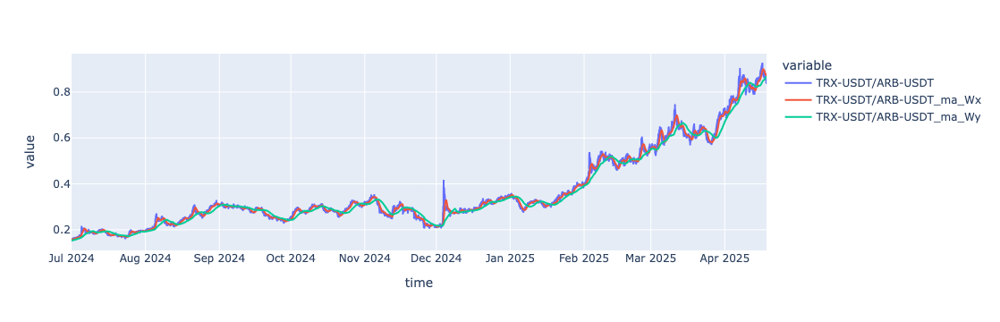

In [361]:
import plotly.express as px

ticker1 = 'TRX-USDT'
ticker2 = 'ARB-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 30
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 120
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

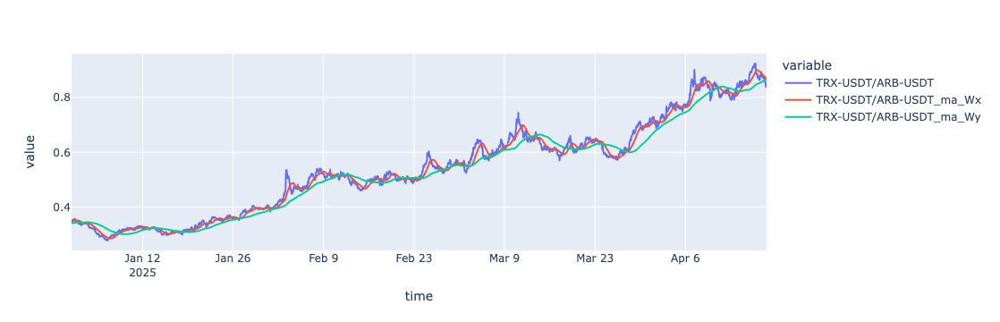

In [363]:
mask = df['time'] >= pd.Timestamp('2025-01-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [54]:
#Статистика: +, +, +

In [57]:
# 892 	XRP-USDT / UNI-USDT 	long 	60 	120 	

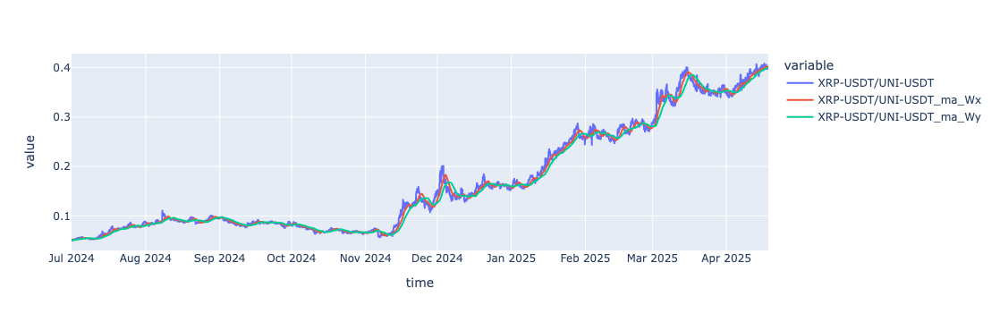

In [365]:
import plotly.express as px

ticker1 = 'XRP-USDT'
ticker2 = 'UNI-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 60
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 120
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

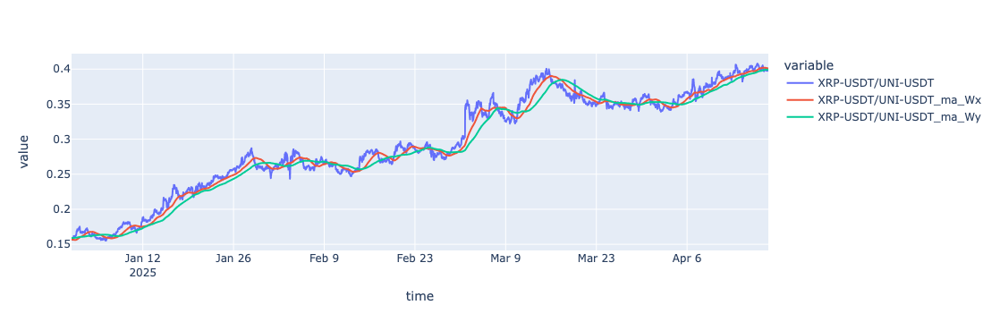

In [367]:
mask = df['time'] >= pd.Timestamp('2025-01-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [ ]:
#Статистика: (30 марта) -, 
# (5 апреля) +

In [131]:
# 855 	XRP-USDT / DOT-USDT 	long 	60 	90

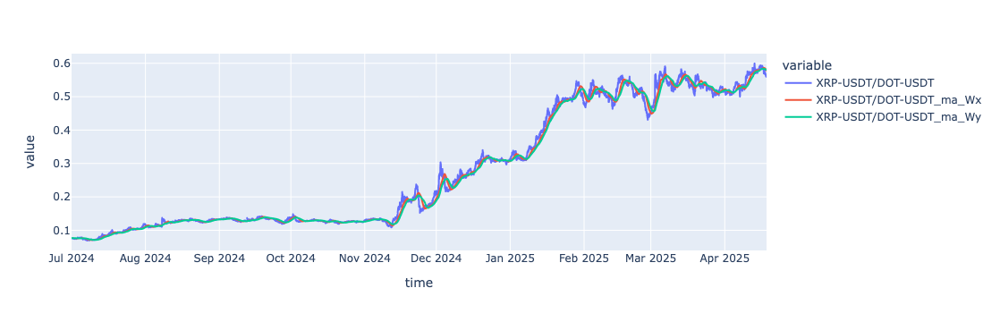

In [369]:
import plotly.express as px

ticker1 = 'XRP-USDT'
ticker2 = 'DOT-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 60
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 90
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

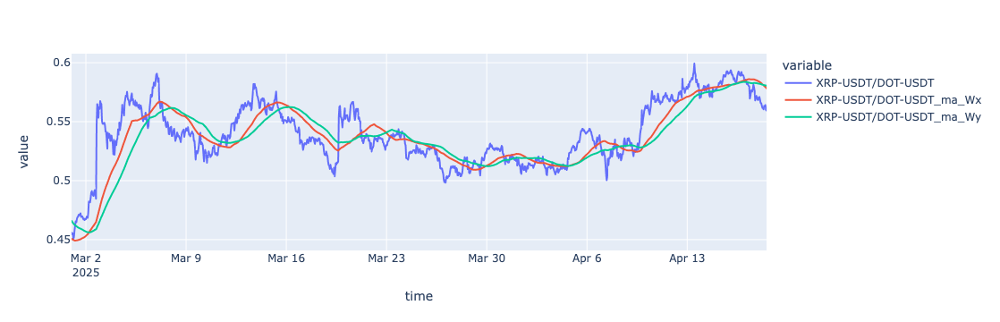

In [373]:
mask = df['time'] >= pd.Timestamp('2025-03-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [57]:
#Статитстика: - (30 марта),
# -
# +
#минусы небольшие, но плюсы сильные


In [59]:
df

,time,XRP-USDT,DOT-USDT,XRP-USDT/DOT-USDT,XRP-USDT/DOT-USDT_ma_Wx,XRP-USDT/DOT-USDT_ma_Wy
0,2024-01-01 00:00:00,0.6193,8.308,0.074543,NaN,NaN
1,2024-01-01 01:00:00,0.6114,8.121,0.075286,NaN,NaN
2,2024-01-01 02:00:00,0.6154,8.203,0.075021,NaN,NaN
3,2024-01-01 03:00:00,0.6161,8.267,0.074525,NaN,NaN
4,2024-01-01 04:00:00,0.6183,8.291,0.074575,NaN,NaN
...,...,...,...,...,...,...
11001,2025-04-03 09:00:00,2.0413,3.990,0.511604,0.513547,0.516255
11002,2025-04-03 10:00:00,2.0524,4.000,0.513100,0.513465,0.516105
11003,2025-04-03 11:00:00,2.0505,4.019,0.510202,0.513343,0.515909
11004,2025-04-03 12:00:00,2.0434,3.991,0.512002,0.513242,0.515754


In [ ]:
# 884 	XRP-USDT / ARB-USDT 	long 	30 	120

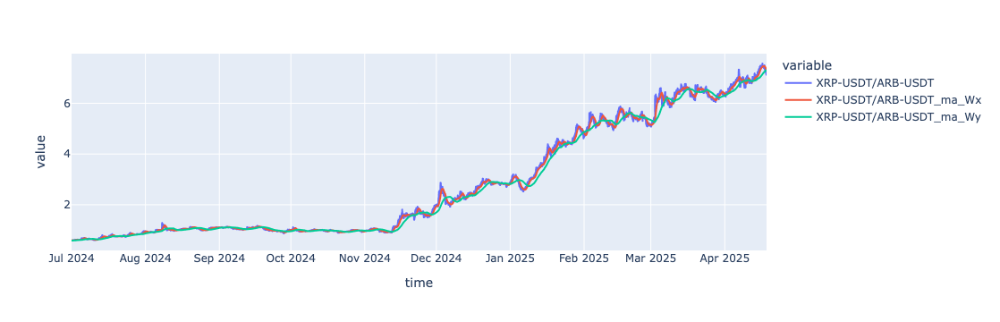

In [375]:
import plotly.express as px

ticker1 = 'XRP-USDT'
ticker2 = 'ARB-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 30
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 120
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

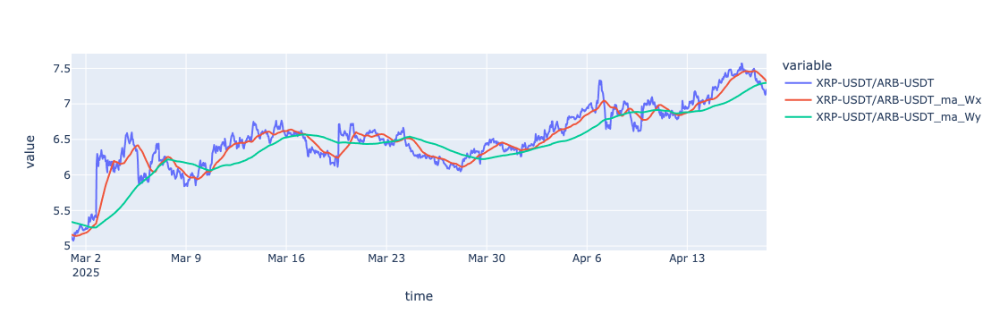

In [377]:
mask = df['time'] >= pd.Timestamp('2025-03-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [ ]:
#Статистика: (29 марта) -, 
# 2 апреля +

#в продолжительности во временри - она вытягивает

In [196]:
time_start = pd.Timestamp('2025-04-2 14:00:00')
time_end = pd.Timestamp('2025-04-3 14:00:00')

mask_start = df['time'] == time_start
mask_end = df['time'] == time_end

x_start, x_end = df.loc[mask_start, ticker1].iloc[0], df.loc[mask_end, ticker1].iloc[0]
y_start, y_end = df.loc[mask_start, ticker2].iloc[0], df.loc[mask_end, ticker2].iloc[0]

get_income_rate(x_start, x_end, y_start, y_end)

1.015700748349914

In [23]:
# 2227 	XLM-USDT / LDO-USDT 	long 	30 	90

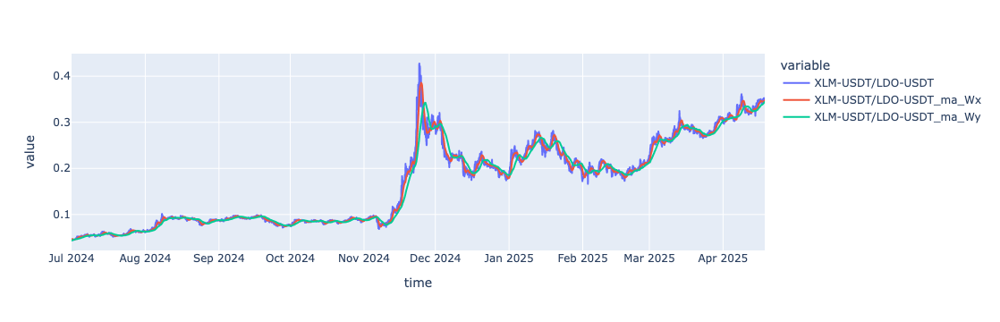

In [379]:
import plotly.express as px

ticker1 = 'XLM-USDT'
ticker2 = 'LDO-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 30
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 90
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

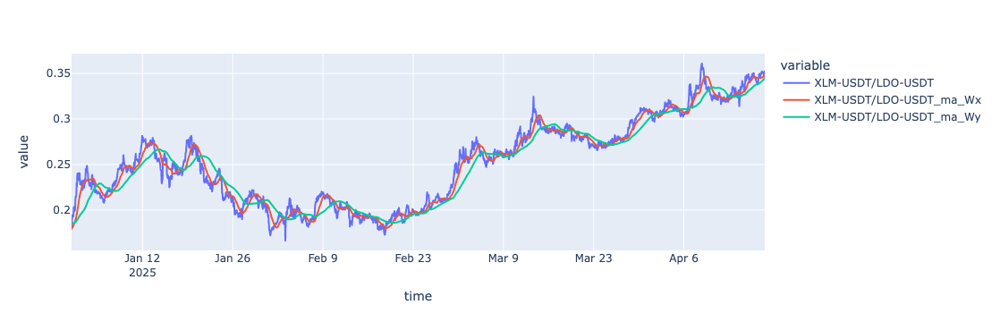

In [381]:
mask = df['time'] >= pd.Timestamp('2025-01-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [ ]:
#Статистика: 25 марта +
# 3 апреля ?

In [124]:
time_start = pd.Timestamp('2025-04-3 7:00:00')
time_end = pd.Timestamp('2025-04-3 22:00:00')

mask_start = df['time'] == time_start
mask_end = df['time'] == time_end

x_start, x_end = df.loc[mask_start, ticker1].iloc[0], df.loc[mask_end, ticker1].iloc[0]
y_start, y_end = df.loc[mask_start, ticker2].iloc[0], df.loc[mask_end, ticker2].iloc[0]

get_income_rate(x_start, x_end, y_start, y_end)

1.0087077274860206

In [69]:
# 1505 	TRX-USDT / TON-USDT 	long 	90 	120 <-

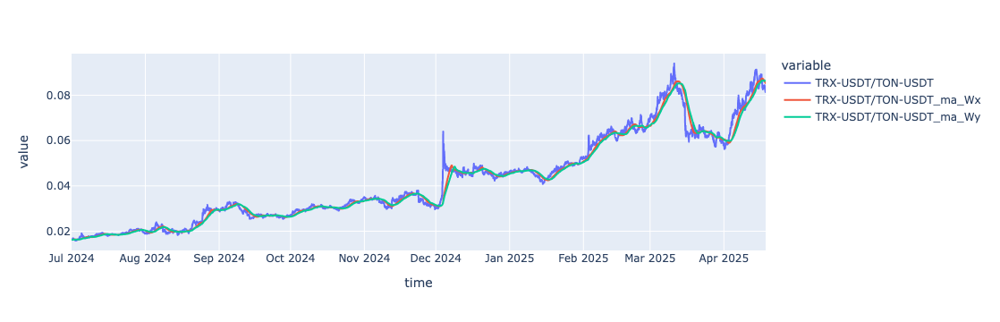

In [383]:
import plotly.express as px

ticker1 = 'TRX-USDT'
ticker2 = 'TON-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 90
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 120
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

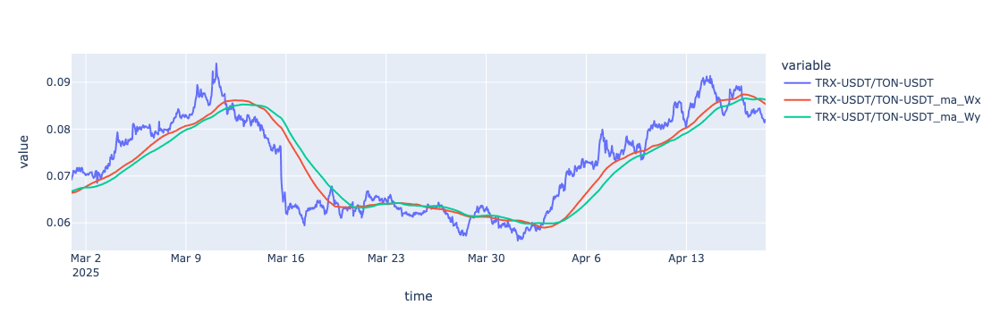

In [385]:
mask = df['time'] >= pd.Timestamp('2025-03-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [224]:
#Статистика: 1 апреля +,

In [226]:
df

,time,TRX-USDT,TON-USDT,TRX-USDT/TON-USDT,TRX-USDT/TON-USDT_ma_Wx,TRX-USDT/TON-USDT_ma_Wy
0,2024-01-01 00:00:00,0.10892,2.330,0.046747,NaN,NaN
1,2024-01-01 01:00:00,0.10778,2.301,0.046841,NaN,NaN
2,2024-01-01 02:00:00,0.10761,2.326,0.046264,NaN,NaN
3,2024-01-01 03:00:00,0.10833,2.337,0.046354,NaN,NaN
4,2024-01-01 04:00:00,0.10818,2.329,0.046449,NaN,NaN
...,...,...,...,...,...,...
11154,2025-04-09 18:00:00,0.23030,3.012,0.076461,0.075261,0.074367
11155,2025-04-09 19:00:00,0.23131,3.050,0.075839,0.075291,0.074403
11156,2025-04-09 20:00:00,0.23460,3.193,0.073473,0.075298,0.074430
11157,2025-04-09 21:00:00,0.23596,3.181,0.074178,0.075312,0.074456


In [229]:
# 1508 	TRX-USDT / NEAR-USDT 	long 	30 	120 	

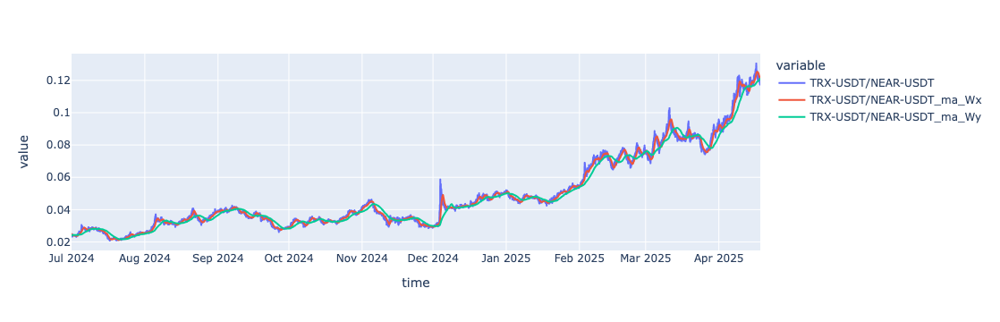

In [387]:
import plotly.express as px

ticker1 = 'TRX-USDT'
ticker2 = 'NEAR-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 30
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 120
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

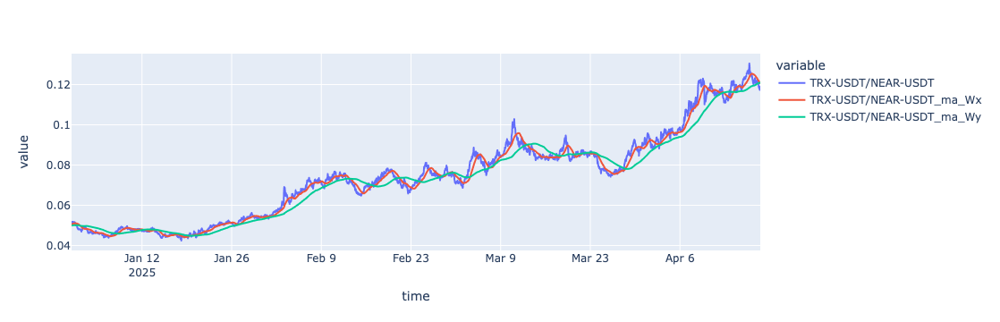

In [389]:
mask = df['time'] >= pd.Timestamp('2025-01-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [97]:
#Статистика: 28 марта +, покупать на пересечении, продавать на загибе ma60

In [134]:
# 402 	BTC-USDT / DOT-USDT 	long 	30 	60

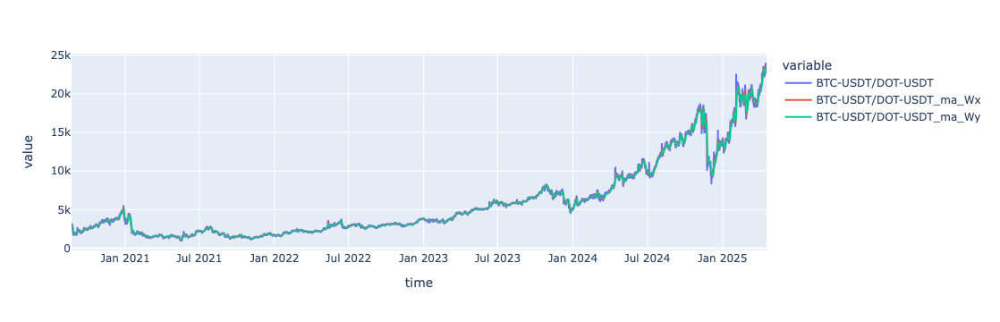

In [391]:
import plotly.express as px

ticker1 = 'BTC-USDT'
ticker2 = 'DOT-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]

window = 30
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 60
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2020-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

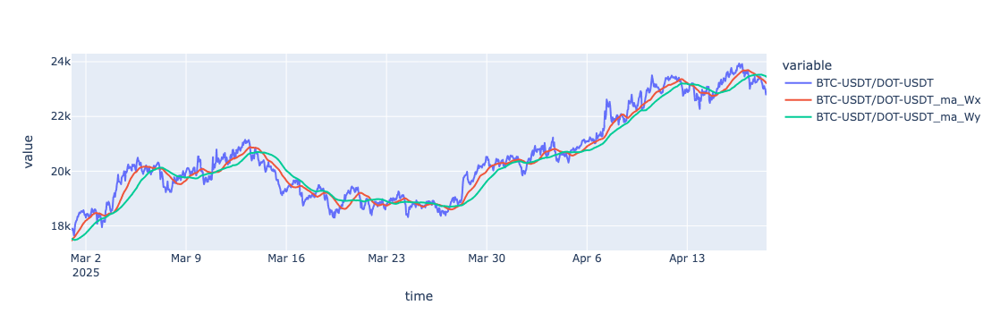

In [395]:
mask = df['time'] >= pd.Timestamp('2025-03-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

In [90]:
#Статистика: 28 марта +, 

In [92]:
# 3283 	AAVE-USDT / ARB-USDT 	long 	30 	90

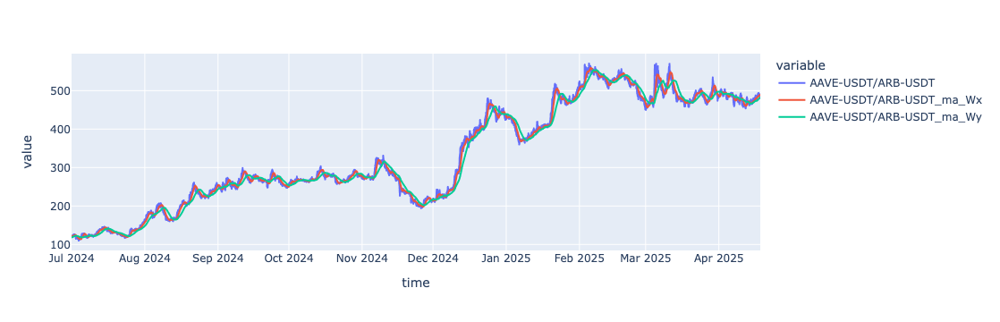

In [397]:
import plotly.express as px

ticker1 = 'AAVE-USDT'
ticker2 = 'ARB-USDT'

df1 = load_pkl(f'./data/raw/1hour/{ticker1}.pkl')
df2 = load_pkl(f'./data/raw/1hour/{ticker2}.pkl')
 
df1[ticker1] = df1['close']
df2[ticker2] = df2['close']

df = df1.merge(df2, on='time', how='inner')[['time', ticker1, ticker2]]

df[f'{ticker1}/{ticker2}'] = df[ticker1]/df[ticker2]
window = 30
df[f'{ticker1}/{ticker2}_ma_Wx'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values
window = 90
df[f'{ticker1}/{ticker2}_ma_Wy'] = df[f'{ticker1}/{ticker2}'].rolling(window=window, min_periods=window).mean().values

mask = df['time'] >= pd.Timestamp('2024-07-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))

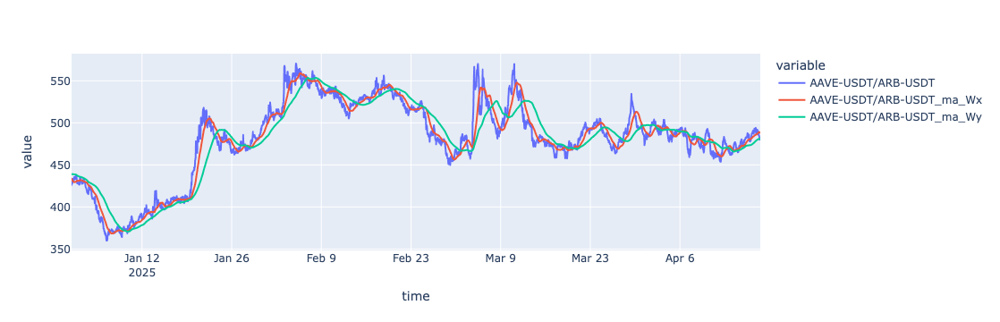

In [399]:
mask = df['time'] >= pd.Timestamp('2025-01-01')
px.line(df.loc[mask, ['time',f'{ticker1}/{ticker2}', f'{ticker1}/{ticker2}_ma_Wx', f'{ticker1}/{ticker2}_ma_Wy']].set_index('time'))